In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# SCohenLab 2D Image Processing notebook

--------------

## GOAL:  Infer sub-cellular components in order to understand interactome 

To measure shape, position, size, and interaction of eight organelles/cellular components (Nuclei (NU), Lysosomes (LS),Mitochondria (MT), Golgi (GL), Peroxisomes (PO), Endoplasmic Reticulum (ER), Lipid Droplet (LD), and SOMA) during differentiation of iPSCs, in order to understand the Interactome / Spatiotemporal coordination.

### summary of OBJECTIVES
- Infersubcellular objects - i.e. extent, size, shape, position
  - infer NUCLEI - NU, ch 0
  - Infer each cells extent: SOMA - SO, composite icluding ch 1, ch 4,ch 5, and ch 7 "residuals"
  - Infer CYTOSOL - CY (SO minus)
  - Infer LYSOSOMES  - LS, ch 1
  - Infer MiIOCHONDRIA - MT, ch 2
  - Infer GOLGI complex - GL, ch 3
  - Infer PEROZISOMES - PO, ch  
  - Infer ENDOPLASMIC RETICULUM - ER, ch 5
  - Infer LD, ch 6 (lipo bodies?)


Computationally, segmentations are most often represented as images, of the same size as the original image, containing integer *labels*, with one value representing one object.

### INFERENCE OF SUB-CELLULAR OBJECTS
The imported images have already been pre-processed to transform the 32 channel spectral measuremnts into "linearly unmixed" images which estimate independently labeled sub-cellular components.  Thes 7 channels (plus a residual "non-linear" signal) will be used to infer the shapes and extents of these sub-cellular components.   
We will perform computational image analysis on the pictures (in 2D an 3D) to _segment_ the components of interest for measurement.  In other prcoedures we can used these labels as "ground truth" labels to train machine learning models to automatically perform the inference of these objects.

## Segmenting nuclei and measuring cell properties


## imports

we are using `napari` for visualization, and `scipy` `ndimage` and `skimage` for analyzing the image files.  The underlying data format are `numpy` `ndarrays` and tools from  Allen Institute for Cell Science.

In [2]:
# this needs to be organzied to explain the imports
import numpy as np
from scipy import ndimage as ndi

import napari

from skimage.segmentation import watershed
from skimage.feature import peak_local_max

from napari_aicsimageio.core import  reader_function as my_reader
from pathlib import Path

import os



# package for 3d visualization
#from itkwidgets import view                              
# from aicssegmentation.core.visual import seg_fluo_side_by_side,  single_fluorescent_view, segmentation_quick_view
# import matplotlib.pyplot as plt
# plt.rcParams["figure.figsize"] = [16, 12]

# # package for io 
# from aicsimageio import AICSImage
# from aicsimageio.writers import OmeTiffWriter

# function for core algorithm
import aicssegmentation

from aicssegmentation.core.seg_dot import dot_3d_wrapper
from aicssegmentation.core.pre_processing_utils import intensity_normalization, image_smoothing_gaussian_3d,  image_smoothing_gaussian_slice_by_slice
from skimage.morphology import remove_small_objects, binary_closing, ball , dilation   # function for post-processing (size filter)
from aicssegmentation.core.utils import topology_preserving_thinning
from aicssegmentation.core.MO_threshold import MO

from skimage import filters
from skimage import morphology



### get the list of all our images with a single Z-slice

In [5]:
#[x for x if ".tif" in x for in os.walk(img_folder)]
#os.listdir(img_folder+'*.tif')
#"/Users/ahenrie/Projects/Imaging/mcz_subcell/cellprofiler/SCohenLab/hiPSCs_7Orgn_January2022/ZSTACK_PBTOhNGN2_BR3_N16_Unmixed-1.tif"
tif_img_folder = f"/Users/ahenrie/Projects/Imaging/mcz_subcell/cellprofiler/SCohenLab/hiPSCs_7Orgn_January2022"
czi_img_folder = f"/Users/ahenrie/Projects/Imaging/mcz_subcell/data"

list_img_files = lambda img_folder,f_type: [os.path.join(img_folder,f_name) for f_name in os.listdir(img_folder) if f_name.endswith(f_type)]

tif_img_list = list_img_files(tif_img_folder,'.tif')
czi_img_list = list_img_files(czi_img_folder,'.czi')
print(czi_img_list)


['/Users/ahenrie/Projects/Imaging/mcz_subcell/data/ZSTACK_PBTOhNGN2hiPSCs_BR3_N08_Unmixed.czi', '/Users/ahenrie/Projects/Imaging/mcz_subcell/data/ZSTACK_PBTOhNGN2hiPSCs_BR1_N16_Unmixed.czi', '/Users/ahenrie/Projects/Imaging/mcz_subcell/data/ZSTACK_PBTOhNGN2hiPSCs_BR2_N02_Unmixed.czi', '/Users/ahenrie/Projects/Imaging/mcz_subcell/data/ZSTACK_PBTOhNGN2hiPSCs_BR3_N14_Unmixed.czi', '/Users/ahenrie/Projects/Imaging/mcz_subcell/data/ZSTACK_PBTOhNGN2hiPSCs_BR3_N01_Unmixed.czi', '/Users/ahenrie/Projects/Imaging/mcz_subcell/data/ZSTACK_PBTOhNGN2hiPSCs_BR3_N04_Unmixed.czi', '/Users/ahenrie/Projects/Imaging/mcz_subcell/data/ZSTACK_PBTOhNGN2hiPSCs_BR3_N11_Unmixed.czi', '/Users/ahenrie/Projects/Imaging/mcz_subcell/data/ZSTACK_PBTOhNGN2hiPSCs_BR1_N21_Unmixed.czi', '/Users/ahenrie/Projects/Imaging/mcz_subcell/data/ZSTACK_PBTOhNGN2hiPSCs_BR2_N07_Unmixed.czi', '/Users/ahenrie/Projects/Imaging/mcz_subcell/data/ZSTACK_PBTOhNGN2hiPSCs_BR2_N04_Unmixed.czi', '/Users/ahenrie/Projects/Imaging/mcz_subcell/data

Read the data into memeory from the `.czi` files.  (Note: there is also the 2D slice .tif file read for later comparision).  WE will also collect metatdata.

In [47]:
czi_image_name = czi_img_list[0]
out = my_reader(czi_image_name)
#(data, [meta_dict, [layer_type]])
img_data, meta_dict, layer_type = out[0]

# this is the matching tif for later reference
tif_img_name = '/Users/ahenrie/Projects/Imaging/mcz_subcell/cellprofiler/SCohenLab/hiPSCs_7Orgn_January2022/ZSTACK_PBTOhNGN2_BR3_N08_Unmixed-1.tif'
out_tif = my_reader(tif_img_name)

29-Jul-22 10:16:49 - aicsimageio.readers.ome_tiff_reader - ERROR    - Failed to parse XML for the provided file.
29-Jul-22 10:16:49 - aicsimageio.readers.ome_tiff_reader - ERROR    - not well-formed (invalid token): line 1, column 6


In [7]:
channel_names = meta_dict['name']
meta_dict['metadata'].keys()

dict_keys(['aicsimage', 'raw_image_metadata'])

In [48]:
#channel_names = meta_dict['metadata'].channel_names

img = meta_dict['metadata']['aicsimage']
raw_meta_data = meta_dict['metadata']['raw_image_metadata']


In [49]:
# collect directly from AiscImage object
print(f"shape: {img.shape}")
print(f"dtype: {img.dtype}")
print(f"range: ({img.data.min()}, {img.data.max()})")

pixels_microns = img.physical_pixel_sizes
chan_names = img.channel_names

shape: (1, 8, 22, 768, 768)
dtype: uint16
range: (0, 65535)


Because the metadata does NOT conform to OME standards we need to add a helper function to help dump/ parse it.

In [50]:
from collections import defaultdict

def etree_to_dict(t):
    d = {t.tag: {} if t.attrib else None}
    children = list(t)
    if children:
        dd = defaultdict(list)
        for dc in map(etree_to_dict, children):
            for k, v in dc.items():
                dd[k].append(v)
        d = {t.tag: {k: v[0] if len(v) == 1 else v
                     for k, v in dd.items()}}
    if t.attrib:
        d[t.tag].update(('@' + k, v)
                        for k, v in t.attrib.items())
    if t.text:
        text = t.text.strip()
        if children or t.attrib:
            if text:
                d[t.tag]['#text'] = text
        else:
            d[t.tag] = text
    return d


In [51]:
(raw_meta_data)

<Element 'ImageDocument' at 0x16ee86770>

# TODO:  loop through all the Z-slices in the full ZSTACK (i.e. .czi file) to find which Z was chosen for these tif files

# WARNING:  the meta-data for the tif files is INCOMPLETE!!!!  it consists of a short string.
e.g. 'ImageJ=1.53f\nimages=8\nchannels=8\nhyperstack=true\nmode=color\nunit=micron\nspacing=0.5804527163320905\nloop=false\nmin=0.0\nmax=65535.0'

\
Note that in the `img_data` the Z dimension has been _squeezed()_ has the 

> # FOLLOW UP WITH MCZ
> ## non-conformity of the meta_data in the .czi file


Check the size of the data we are reading... 8 channels, 22 Z slices, and 768x768 pixels.

In [52]:
print(img_data.shape)


(8, 22, 768, 768)


In [53]:
# alternate way to read in the data.. (access to the ACIO object)
c = 0
tmp1 = img.get_image_data("ZYX", C=c)
tmp1.shape

tmp2 = img_data[c, : , : ]

tmp1.shape, tmp2.shape, (tmp1[:]-tmp2[:]).max(), pixels_microns


((22, 768, 768),
 (22, 768, 768),
 0,
 PhysicalPixelSizes(Z=5.804527163320905, Y=7.987165184837317, X=7.987165184837317))

Although the data is not available from the .tif images, we know that the pixel spacing in this dataset is 05.8µm in the z (leading!) axis, and 0.80µm in the x and y axes.  We can read this directly from the .czi meta data.  I have commented out meta information we don't currently need.

In [14]:

# x = 5.8 # float(voxels['Distance'][0]['Value']) * 10e6
# y = 5.8 #float(voxels['Distance'][1]['Value']) * 10e6
# spacing = np.array([x, y])
# spacing
# not much use here.. but worth checking...
#Use function above to convert xml to dict
tmp_meta_dict = etree_to_dict(raw_meta_data)
meta = tmp_meta_dict['ImageDocument']['Metadata']
#meta['Version'] #, 
# meta['Experiment']
#meta['CustomAttributes']
# meta['Information'], 
voxels = meta['Scaling']['Items']
voxels
#meta['DisplaySetting']
#meta['Layers']
#meta['Appliances']

x = float(voxels['Distance'][0]['Value']) * 10e6
y = float(voxels['Distance'][1]['Value']) * 10e6
spacing = np.array([x, y])
spacing

array([0.79871652, 0.79871652])

## visualize with `napari`
Load the data into napari for viewing

In [15]:
#defaults colormaps are fine
#colormaps = ['magenta', 'cyan', 'red', 'yellow', 'blue', 'green','bop orange','bop blue']

viewer = napari.Viewer()
# for c, c_name in enumerate(chan_names):
#     # viewer.add_image(   img.get_image_data("ZYX", C=c), 
#     #                                     name=c_name, colormap=colormaps[c % 4], blending='additive')
    
#     viewer.add_image(img_data[c,:,:], 
#                                     name=c_name, 
#                                     colormap=colormaps[c % 4], 
#                                     blending='additive',   
#                                     scale=spacing)

# load multichannel image in one line, with additional options
viewer = napari.view_image(
        img_data,
        channel_axis=0,
        name=chan_names,
        #colormap=colormaps, 
        scale = spacing
        )

Assistant skips harvesting pyclesperanto as it's not installed.


/opt/anaconda3/envs/napariCPU/lib/python3.9/site-packages/napari_tools_menu/__init__.py:194: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.tools_menu = ToolsMenu(self, self.qt_viewer.viewer)
/opt/anaconda3/envs/napariCPU/lib/python3.9/site-packages/napari_tools_menu/__init__.py:194: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.tools_menu = ToolsMenu(self, self.qt_viewer.viewer)


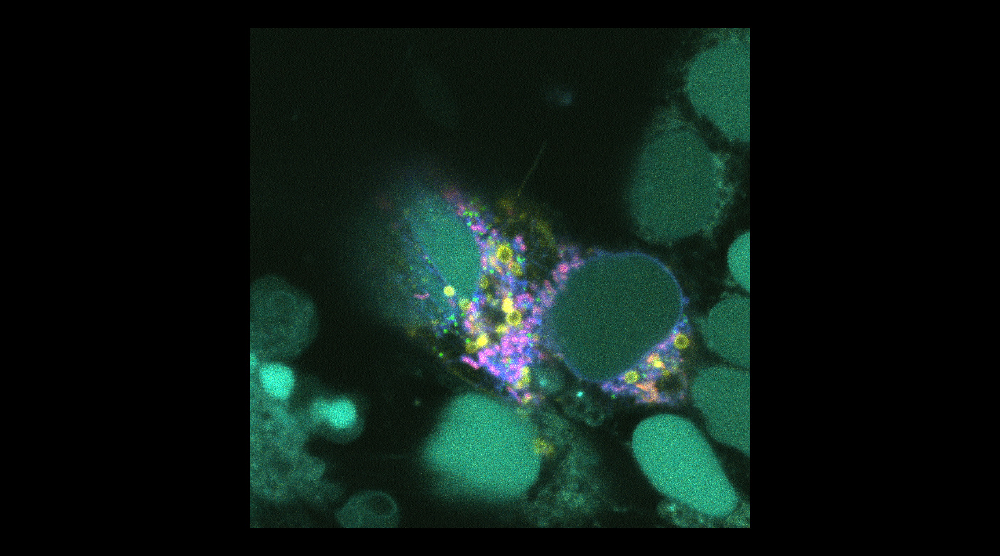

In [20]:
from napari.utils.notebook_display import nbscreenshot

nbscreenshot(viewer, canvas_only=True)


We can view the 3D image using napari.


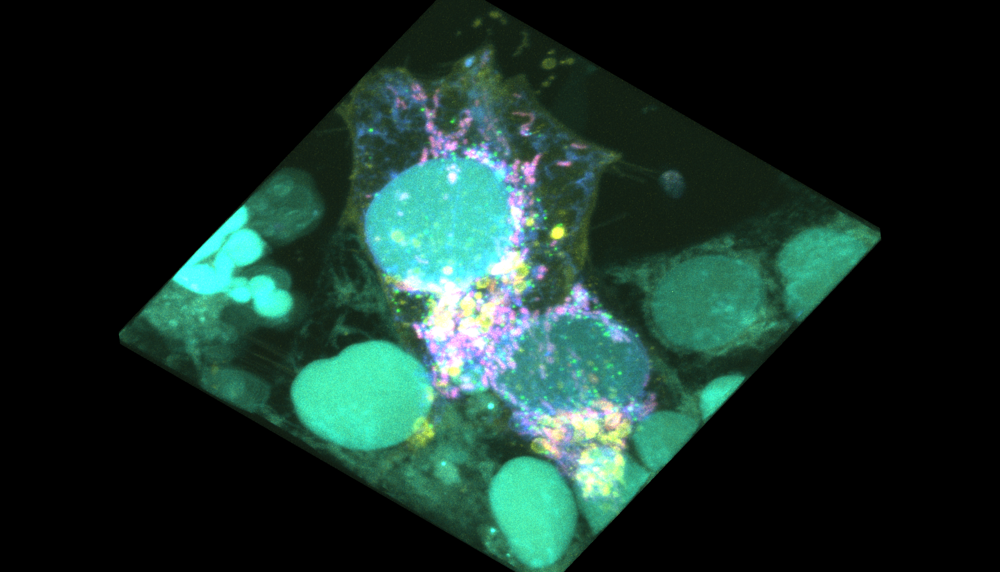

In [21]:

viewer.dims.ndisplay = 3
viewer.camera.angles = (-30, 25, 120)
nbscreenshot(viewer, canvas_only=True)



> read tiff for comarison

In [18]:
img_data_tif, meta_dict_tif, layer_type_tif = out_tif[0]

img_data_tif.shape

n_times = img_data.shape[1]
print(img_data_tif.shape, img_data_tif.max(), img_data.shape, img_data.max())

residual = img_data-img_data_tif[:,np.newaxis,:,:]

residual.shape, residual[0,:,:,:].max(), img_data.shape, img_data_tif.shape, img_data_tif[:,np.newaxis,:,:].shape

(8, 768, 768) 61498 (8, 22, 768, 768) 65535


((8, 22, 768, 768), 65535, (8, 22, 768, 768), (8, 768, 768), (8, 1, 768, 768))

## Normaize each channel and replace the images


## Create "soma" aggregate



# OBJECTIVE 1. infer NUCLEI

### recreate CellProfiler 2D workflow
### "part-1" CellProfiler pipeline


- get data from channel 0, the nuclei , NU
- scale to min 0, max 1.0
- median Filter window 10

- threshold method minimum cross-entropy.  
  - objects 50-400 pixels, 
  - threshold smoothing scale: 1 pixel
  - threshold correction factor: 1.2 (more stringent)
  - lower / upper bounds  (.1,1)
  - log transformed thresholding
  - fill holes



In [22]:

nuclei = img_data[0,:,:,:]

## PARAMETER ##
intensity_scaling_param =[0] #to 0,1... contrast normalization -> [9,19]
gaussian_smoothing_sigma = 10
################################
# intensity normalization
#nucl_norm = aicssegmentation.core.pre_processing_utils.intensity_normalization(Nuclei, scaling_param=intensity_scaling_param)
nuclei_norm = intensity_normalization(nuclei, scaling_param=intensity_scaling_param)

# smoothing with gaussian filter
#nuclei_norm_smooth = image_smoothing_gaussian_slice_by_slice(nuclei_norm, sigma=gaussian_smoothing_sigma)
#nucl_norm_smooth3D = image_smoothing_gaussian_3d(nucl_norm, sigma=gaussian_smoothing_sigma)

intensity normalization: min-max normalization with NO absoluteintensity upper bound


In [23]:
aicssegmentation.core.pre_processing_utils.suggest_normalization_param(nuclei)
# tmp_2Dv3d = np.concatenate([nucl_norm_smooth, nucl_norm_smooth3D],axis=2)

mean intensity of the stack: 4171.635149869052
the standard deviation of intensity of the stack: 6049.721652015895
0.9999 percentile of the stack intensity is: 51897.387299999595
minimum intensity of the stack: 0
maximum intensity of the stack: 65535
suggested upper range is 8.0, which is 52569.40836599621
suggested lower range is 0.5, which is 1146.7743238611042
So, suggested parameter for normalization is [0.5, 8.0]
To further enhance the contrast: You may increase the first value (may loss some dim parts), or decrease the second value(may loss some texture in super bright regions)
To slightly reduce the contrast: You may decrease the first value, or increase the second value


#### Median FIltering for 2D
We need to define a wrapper for `median_filter` which steps through each Z-slice independently.  (Note: since we will use this pattern repeatedly we may want to make a generic wrapper for our filtering/de-noising). Lets call it `median_filter_slice_by_slice` and copy the way the `aicssegmentation` package handles smoothing.

In [35]:
# nucl_norm.max(), Nuclei.max(), nucl_norm.shape
# viewer.add_image(
#     tmp_2Dv3d)



def median_filter_slice_by_slice(struct_img, size):
    """
    wrapper for applying 2D median filter slice by slice on a 3D image
    """
    from scipy.ndimage import median_filter
    structure_img_denoise = np.zeros_like(struct_img)
    for zz in range(struct_img.shape[0]):
        structure_img_denoise[zz, :, :] = median_filter(struct_img[zz, :, :], size=size) 
        
    return structure_img_denoise


Now lets add it to our napari viewer to see how it does.   TODO: adjust parameters to make it visualize well.. .i.e. turn off all the layers save nuclei?

In [25]:


viewer.add_image(
    nuclei_norm,
    scale=spacing,
    opacity=0.3,
)

<Image layer 'nuclei_norm' at 0x17869b790>

Lets spot check how median filtering works in 2D vs 3D.  _A priorii_ we assume that the noise in the signal that we are trying to remove is independent between Z-slices, _and_ that the intensity for truly continuous objects between Z-slices will change slowly... so at least for sufficiently large objects (on the order of our filter size **3) the medians should be the same whether 2D or 3D.

Also, these median filters are SLOOOOOOW.   numpy.signal has a 2D median filter that may be more optimal... also need to look at other implimentations.

In [44]:
# this takes to minutes!  2m 20.2s


raw_denoised1 = ndi.median_filter( nuclei,    size=10  ) 
raw_denoised2 = median_filter_slice_by_slice( nuclei,    size=10  )


In [ ]:
# this takes to minutes!  2m 19.9s
denoised1 = ndi.median_filter( nuclei_norm,    size=10  )
denoised2 = median_filter_slice_by_slice( nuclei_norm,    size=10  )

(denoised1-denoised2).mean(), (denoised1-denoised2).std()

In [46]:
denoised1raw = intensity_normalization(raw_denoised1, scaling_param=intensity_scaling_param)
denoised2raw = intensity_normalization(raw_denoised2, scaling_param=intensity_scaling_param)

((denoised1-denoised2).mean(), (denoised1-denoised2).std()), ((denoised2raw-denoised2).mean(), (denoised2raw-denoised2).std()), (denoised2raw.mean(),denoised2raw.std()), (denoised2.mean(),denoised2.std())

intensity normalization: min-max normalization with NO absoluteintensity upper bound
intensity normalization: min-max normalization with NO absoluteintensity upper bound


((-0.0024397919305525796, 0.025507579177562),
 (0.018644254398800644, 0.026493026488258957),
 (0.08159273536064027, 0.11594126817417783),
 (0.06294848096183961, 0.08944824168591893))

#### Thresholding
Need to check whether _Li_ procedure or _Otsu_ better matches the CellProfiler pipeline.
> [Thresholding](https://en.wikipedia.org/wiki/Thresholding_%28image_processing%29) is used to create binary images. A threshold value determines the intensity value separating foreground pixels from background pixels. Foregound pixels are pixels brighter than the threshold value, background pixels are darker. In many cases, images can be adequately segmented by thresholding followed by labelling of *connected components*, which is a fancy way of saying "groups of pixels that touch each other".
> 
> Different thresholding algorithms produce different results. [Otsu's method](https://en.wikipedia.org/wiki/Otsu%27s_method) and [Li's minimum cross entropy threshold](https://scikit-image.org/docs/dev/auto_examples/developers/plot_threshold_li.html) are two common algorithms. Below, we use Li. You can use `skimage.filters.threshold_<TAB>` to find different thresholding methods.

In [56]:


# note that thresholding is on values, so no difference  bewtween 3D and 2D
nuclei_object  = denoised2 > filters.threshold_li(denoised2)


Add the thresholded nuclei to the napari viewer

In [57]:


# viewer.add_image(
#     nuclei,
#     scale=spacing,
#     opacity=0.3,
# )

# viewer.add_image(
#     denoised2,
#     scale=spacing,
#     opacity=0.3,
# )

# viewer.add_image(
#     denoised1,
#     scale=spacing,
#     opacity=0.3,
# )

viewer.add_image(
    nuclei_object,
    scale=spacing,
    opacity=0.3,
)


<Image layer 'nuclei_object' at 0x16eecf940>

# OBJECTIVE 2. Infer SOMA

- combine channels 1,4,5, and 7
- scale to max 1.0
- gaussian blur, sigma = 10 pixels
- median filter, window = 5
- identify secondary objects
  - watershed from NU, global threshold, minimum cross-entropy
  - threshold smoothing scale: 1 pixel
  - threshold correction factor: .5 (more lenient)
  - lower / upper bounds  (0,1)
  - log transformed thresholding
  - fill holes
  - discard objects on borde
- keep only the "most intense" Soma


In [59]:
#step 1
composite_channels = [1,4,5,7]
soma = img_data[composite_channels,:,:,:].sum(axis=0)
#step 2
soma_norm = soma/soma[:].max()

#step 3
gaussian_smoothing_sigma = 10
# smoothing with gaussian filter
soma_norm_smooth = image_smoothing_gaussian_slice_by_slice(soma_norm, sigma=gaussian_smoothing_sigma)
#soma_norm_smooth3D = image_smoothing_gaussian_3d(soma_norm, sigma=gaussian_smoothing_sigma)



soma_norm.shape, soma_norm.mean(), soma_norm.max(), soma_norm.min()

((22, 768, 768), 0.030123463664917322, 1.0, 0.000766160424106867)

In [60]:
# step 4. does this help?
soma_norm_smooth_denoised = median_filter_slice_by_slice( soma_norm_smooth,    size=5 )






No visualize these layers.


In [61]:

viewer.add_image(
    soma_norm_smooth,
    scale=spacing,
    opacity=0.3,
)


viewer.add_image(
    soma_norm_smooth_denoised,
    scale=spacing,
    opacity=0.3,
)


viewer.add_image(
    soma_norm,
    scale=spacing,
    opacity=0.3,
)


<Image layer 'soma_norm' at 0x16c653b20>

Now we need to do something a little more complicated:
1. watershed from nuclei objects (part 1) to identify the Soma


A better segmentation would assign different labels to different nuclei. 

Typically we use [watershed segmentation](https://en.wikipedia.org/wiki/Watershed_%28image_processing%29) for this purpose. We place *markers* at the centre of each object, and these labels are expanded until they meet an edge or an adjacent marker.

The trick, then, is how to find these markers. It can be quite challenging to find markers with the right location. A slight amount of noise in the image can result in very wrong point locations. Here is a common approach: find the distance from the object boundaries, then place points at the maximal distance.


In [ ]:
transformed = ndi.distance_transform_edt(remove_objects, sampling=spacing)

maxima = morphology.local_maxima(transformed)
viewer.add_points(
    np.transpose(np.nonzero(maxima)),
    name='bad points',
    scale=spacing,
    size=4,
    n_dimensional=True,  # points have 3D "extent"
)


# 3. Infer Cytosol
- shrink NU
- intersection of NU and SOMA




# A. create SOMA mask 
## "part 2" CellProfiler Pipeline
###  create cell (soma) mask

###  make masked composite
combine channels 0-6 (i.e. no 7) and cell mask

###   Nuclei rescale & mask w/ soma
NU masked w/ SO



# 4. Infer LYSOSOMES
- rescale mask w/cytsol
- LS masked w/ CY
- median filter, 2 pix window
- get "BIG"
  - enhance speckles 
    - > Speckles: A speckle is an area of enhanced intensity relative to its immediate neighborhood. The module enhances speckles using a white tophat filter, which is the image minus the morphological grayscale opening of the image. The opening operation first suppresses the speckles by applying a grayscale erosion to reduce everything within a given radius to the lowest value within that radius, then uses a grayscale dilation to restore objects larger than the radius to an approximation of their former shape. The white tophat filter enhances speckles by subtracting the effects of opening from the original image. 
    - feature size: 40 pix
    - speed/accurace: slow
  - identify primary objects "BIG"
  - adaptive Otsu
    - diameter: (10,100)
    - three classes
      - middle intensity is foreground
      - threshold smoothing scale: 1.34
      - threshold correction factor: .7
      - threshold bounds: (0.08197, 1)
      - adaptive window: 20 pixels
- get "SMALL"
  - enhance speckles 
    - feature size: 10 pix
    - speed/accurace: slow
- identify primary objects "BIG"
  - adaptive Otsu
    - diameter: (2,50)
  - three classes
    - middle intensity is foreground
    - threshold smoothing scale: 1.34
    - threshold correction factor: .75
    - threshold bounds: (0.06, 1)
    - adaptive window: 20 pixels
- combine "BIG" and "SMALL"
 


#  5. Infer Mitochondria 
- rescale mask w/cytsol
- MT masked w/ CY
- non-local noise reduction
  - size:4, distance:2, cut-off:0.1
- median filter, 2 pix window
- identify primary objects
  - adaptive Otsu
    - diameter: (2,200)
  - two classes
    - threshold smoothing scale: 0
    - threshold correction factor: .1
    - threshold bounds: (0.14 1)
    - adaptive window: 20 pixels







# 6. Infer Golgi 
- rescale mask w/cytsol
- GL masked w/ CY
- non-local noise reduction
  - size:4, distance:2, cut-off:0.1
- identify primary objects
- adaptive Otsu
    - diameter: (4,100)
  - two classes
    - threshold smoothing scale: 1.34
    - threshold correction factor: .75
    - threshold bounds: (0.14, 1)
    - adaptive window: 20 pixels

  - adaptive Sauvola
    - threshold smoothing scale: 0
    - threshold correction factor: .6
    - threshold bounds: (0. ,1.0)
    - adaptive window: 20 pixels




# 7. Infer Peroxisomes 
- rescale mask w/cytsol
- PO masked w/ CY
- non-local noise reduction
  - size:4, distance:2, cut-off:0.1
- enhance spreckles
  - feature size:10
- identify primary objects
  - adaptive Sauvola
    - threshold smoothing scale: 1
    - threshold correction factor: 1
    - threshold bounds: (0.05 ,1.0)
    - adaptive window: 10 pixels



#  8. Infer Endoplasmic Reticulum  
- rescale 
- median window:4
- non-local noise reduction
  - size:5, distance:1, cut-off:0.1
- identify "TUBES"
  - enhance neurites
    - > Neurites: Neurites are taken to be long, thin features of enhanced intensity. Choose this option to enhance the intensity of the neurites using the Line structures or Tubeness methods described in a later setting.  
    - method: tubeness
    - > Tubeness: This method is an adaptation of the method used by the ImageJ Tubeness plugin. The image is smoothed with a Gaussian. The Hessian is then computed at every point to measure the intensity gradient and the eigenvalues of the Hessian are computed to determine the magnitude of the intensity. The absolute maximum of the two eigenvalues gives a measure of the ratio of the intensity of the gradient in the direction of its most rapid descent versus in the orthogonal direction. The output image is the absolute magnitude of the highest eigenvalue if that eigenvalue is negative (white neurite on dark background), otherwise, zero. 
    - smoothing: 2 pix
  - ER-Tube masked w/ CY
  - identify primary objects "TUBES"
    - adaptive Sauvola
      - threshold smoothing scale: 0
      - threshold correction factor: .6
      - threshold bounds: (0. ,1.0)
      - adaptive window: 20 pixels
- identify primary objects "SHEETS"
  - ER masked w/ CY
  - adaptive Otsu
      - diameter: (2,50)
    - two classes
      - threshold smoothing scale: 0
      - threshold correction factor: 1
      - threshold bounds: (0.18, .25)
      - adaptive window: 10 pixels
- combine "TUBES" and "SHEETS"
- merge all
  



## Edge detection

We saw the [Sobel operator](https://en.wikipedia.org/wiki/Sobel_operator) in the filters lesson. It is an edge detection algorithm that approximates the gradient of the image intensity, and is fast to compute. The [Scharr filter](https://scikit-image.org/docs/dev/api/skimage.filters.html#skimage.filters.scharr) is a slightly more sophisticated version, with smoothing weights [3, 10, 3]. Both work for n-dimensional images in scikit-image.

In [87]:
from skimage import filters



edges = filters.scharr()

nuclei_layer = viewer.layers['nuclei']
nuclei_layer.blending = 'additive'
nuclei_layer.colormap = 'green'

viewer.add_image(
    edges,
    scale=spacing,
    blending='additive',
    colormap='magenta',
)

NameError: name 'nuclei' is not defined

In [9]:
denoised = ndi.median_filter(nuclei,    size=3  )

In [10]:
li_thresholded = denoised > filters.threshold_li(denoised)

In [11]:
viewer.add_image(
    li_thresholded,
    scale=spacing,
    opacity=0.3,
)

<Image layer 'li_thresholded' at 0x16d843ca0>

#### Morphological operations

> [Mathematical morphology](https://en.wikipedia.org/wiki/Mathematical_morphology) operations and structuring elements are defined in `skimage.morphology`. Structuring elements are shapes which define areas over which an operation is applied. The response to the filter indicates how well the neighborhood corresponds to the structuring element's shape.
> 
> There are a number of two and three dimensional structuring elements defined in `skimage.morphology`. Not all 2D structuring element have a 3D counterpart. The simplest and most commonly used structuring elements are the `disk`/`ball` and `square`/`cube`.

> Functions operating on [connected components](https://en.wikipedia.org/wiki/Connected_space) can remove small undesired elements while preserving larger shapes.
>
> `skimage.morphology.remove_small_holes` fills holes and `skimage.morphology.remove_small_objects` removes bright regions. Both functions accept a size parameter, which is the minimum size (in pixels) of accepted holes or objects. It's useful in 3D to think in linear dimensions, then cube them. In this case, we remove holes / objects of the same size as a cube 20 pixels across.

In [14]:
width = 20

remove_holes = morphology.remove_small_holes(
    li_thresholded, width ** 3
)

In [15]:
width = 20

remove_objects = morphology.remove_small_objects(
    remove_holes, width ** 3
)

viewer.add_image(
    remove_objects,
    name='cleaned',
    scale=spacing,
    opacity=0.3,
);

viewer.layers['li_thresholded'].visible = False

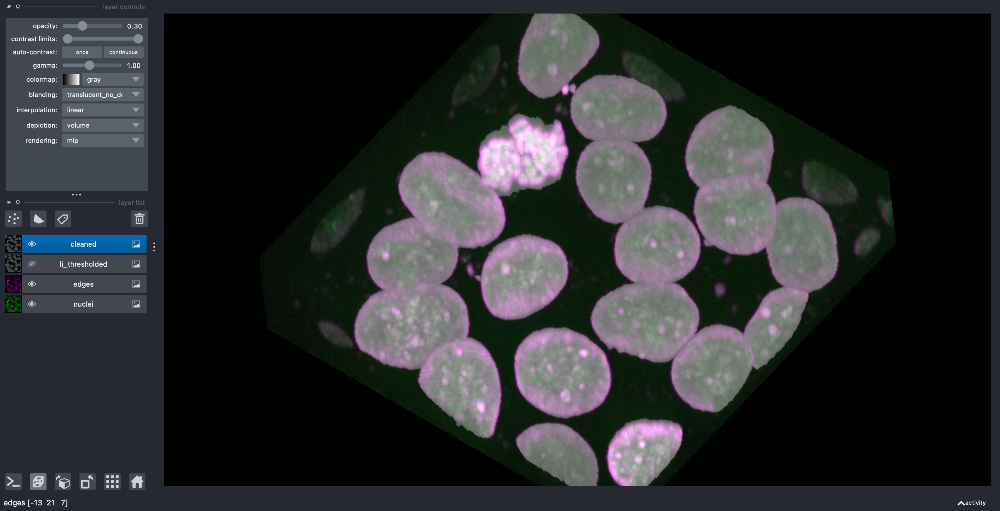

In [16]:
nbscreenshot(viewer)

## Segmentation

Now we are ready to label the connected components of this image.

In [17]:
from skimage import measure

labels = measure.label(remove_objects)

viewer.add_labels(
    labels,
    scale=spacing,
    opacity=0.5,
)

viewer.layers['cleaned'].visible = False

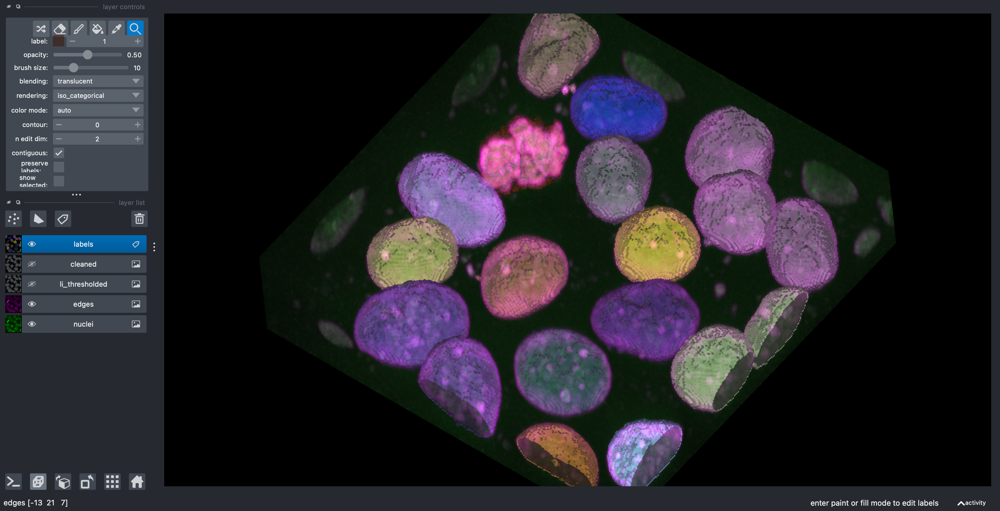

In [18]:
nbscreenshot(viewer)

We can see that tightly packed cells connected in the binary image are assigned the same label.

A better segmentation would assign different labels to different nuclei. 

Typically we use [watershed segmentation](https://en.wikipedia.org/wiki/Watershed_%28image_processing%29) for this purpose. We place *markers* at the centre of each object, and these labels are expanded until they meet an edge or an adjacent marker.

The trick, then, is how to find these markers. It can be quite challenging to find markers with the right location. A slight amount of noise in the image can result in very wrong point locations. Here is a common approach: find the distance from the object boundaries, then place points at the maximal distance.

In [19]:
transformed = ndi.distance_transform_edt(remove_objects, sampling=spacing)

maxima = morphology.local_maxima(transformed)
viewer.add_points(
    np.transpose(np.nonzero(maxima)),
    name='bad points',
    scale=spacing,
    size=4,
    n_dimensional=True,  # points have 3D "extent"
)

<Points layer 'bad points' at 0x16d94faf0>

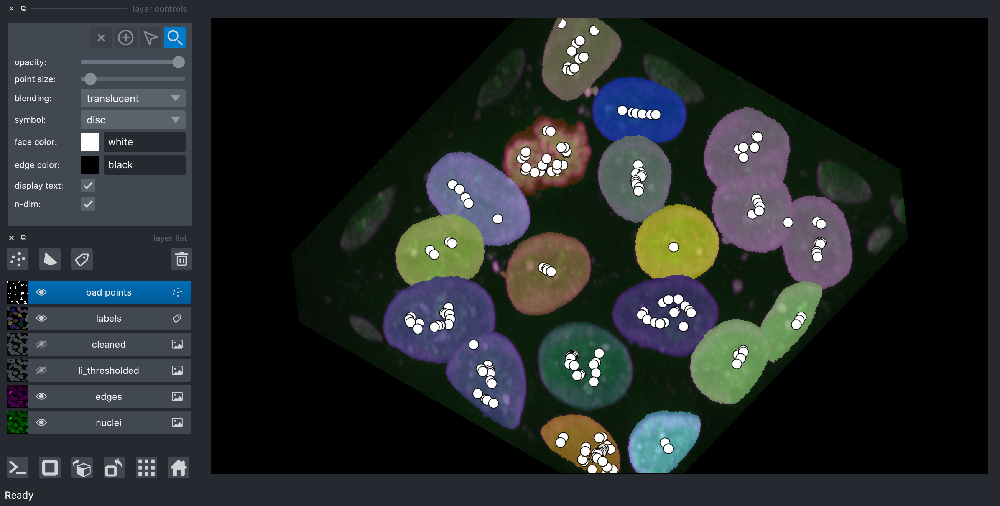

In [20]:
#nbscreenshot(viewer)  #did the conventions change for how points/labels render?  my picture has teh "bad points" obscured

You can see that these points are actually terrible, with many markers found within each nuclei.

### <span style="color:cornflowerblue">Exercise: improve the points</span>

Try to improve the segmentation to assign one point for each nucleus. Some ideas:

- use a smoothed version of the nuclei image directly
- smooth the distance map
- use morphological operations to smooth the surface of the nuclei to ensure that they are close to spherical
- use peak_local_max with `min_distance` parameter instead of `morphology.local_maxima`
- find points on a single plane, then prepend the plane index to the found coordinates

In [20]:
transformed = ndi.distance_transform_edt(remove_objects, sampling=spacing)
transformed = filters.gaussian(transformed, 10)

maxima = morphology.local_maxima(transformed)
viewer.add_points(
    np.transpose(np.nonzero(maxima)),
    name='bad points',
    scale=spacing,
    size=4,
    n_dimensional=True,  # points have 3D "extent"
)

<Points layer 'bad points [1]' at 0x16ddb2b20>

As you will have seen from the previous exercise, there are many approaches to find better seed points, but they are often fiddly and tedious, and sensitive to parameters — when you encounter a new image, you might have to start all over again!

With napari, in many cases, a little interactivity, combined with the segmentation algorithms in scikit-image and elsewhere, can quickly get us the segmentation we want.

Below, you can use full manual annotation, or light editing of the points you found automatically.

In [29]:
viewer.layers['bad points'].visible = False
viewer.dims.ndisplay = 2
viewer.dims.set_point(0, 30 * spacing[0])

points = viewer.add_points(
    name='interactive points',
    scale=spacing,
    ndim=3,
    size=4,
    n_dimensional=True,
)
points.mode = 'add'


# now, we annotate the centers of the nuclei in your image

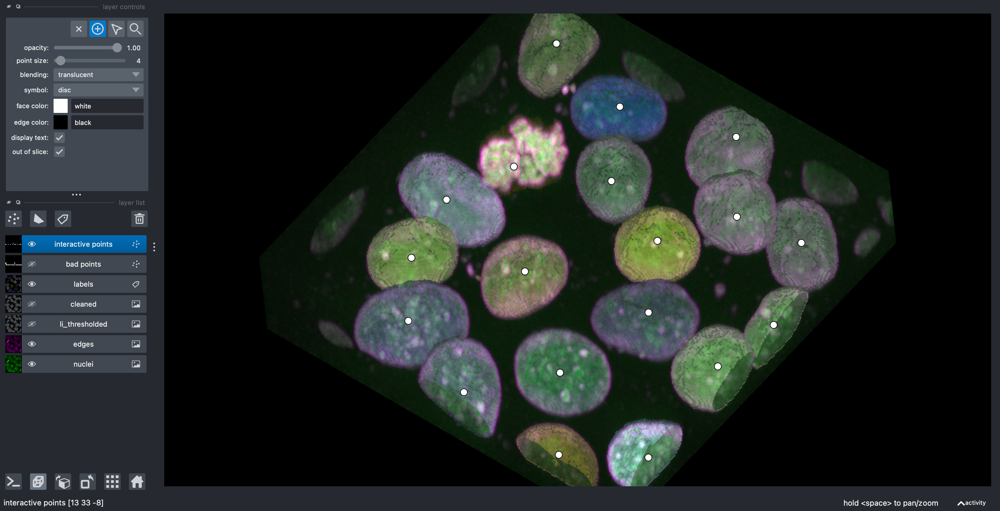

In [31]:
viewer.dims.ndisplay = 3
viewer.camera.angles = (-30, 25, 120)
nbscreenshot(viewer)

In [32]:
# unscaled points.data
# this cell is only to simulate interactive annotation,
# no need to run it if you already have annotations.


# points.data = np.array(
#       [[ 30.        ,  14.2598685 ,  27.7741219 ],
#        [ 30.        ,  30.10416663,  81.36513029],
#        [ 30.        ,  13.32785096, 144.27631406],
#        [ 30.        ,  46.8804823 , 191.80920846],
#        [ 30.        ,  43.15241215, 211.84758551],
#        [ 30.        ,  94.87938547, 160.12061219],
#        [ 30.        ,  72.97697335, 112.58771779],
#        [ 30.        , 138.21820096, 189.01315585],
#        [ 30.        , 144.74232372, 242.60416424],
#        [ 30.        ,  98.14144685, 251.92433962],
#        [ 30.        , 153.59649032, 112.58771779],
#        [ 30.        , 134.49013081,  40.35635865],
#        [ 30.        , 182.95504275,  48.74451649],
#        [ 30.        , 216.04166532,  80.89912152],
#        [ 30.        , 235.14802483, 130.296051  ],
#        [ 30.        , 196.00328827, 169.44078757],
#        [ 30.        , 245.86622651, 202.06140137],
#        [ 30.        , 213.71162148, 250.52631331],
#        [ 28.        ,  87.42324517,  52.00657787]],
#       dtype=float,
# )

Once you have marked all the points, you can grab the data back, and make a markers image for `skimage.segmentation.watershed`:

In [33]:
from skimage import segmentation

marker_locations = points.data

markers = np.zeros(nuclei.shape, dtype=np.uint32)
marker_indices = tuple(np.round(marker_locations).astype(int).T)
markers[marker_indices] = np.arange(len(marker_locations)) + 1
markers_big = morphology.dilation(markers, morphology.ball(5))

segmented = segmentation.watershed(
    edges,
    markers_big,
    mask=remove_objects,
)

viewer.add_labels(
    segmented,
    scale=spacing,
)

viewer.layers['labels'].visible = False

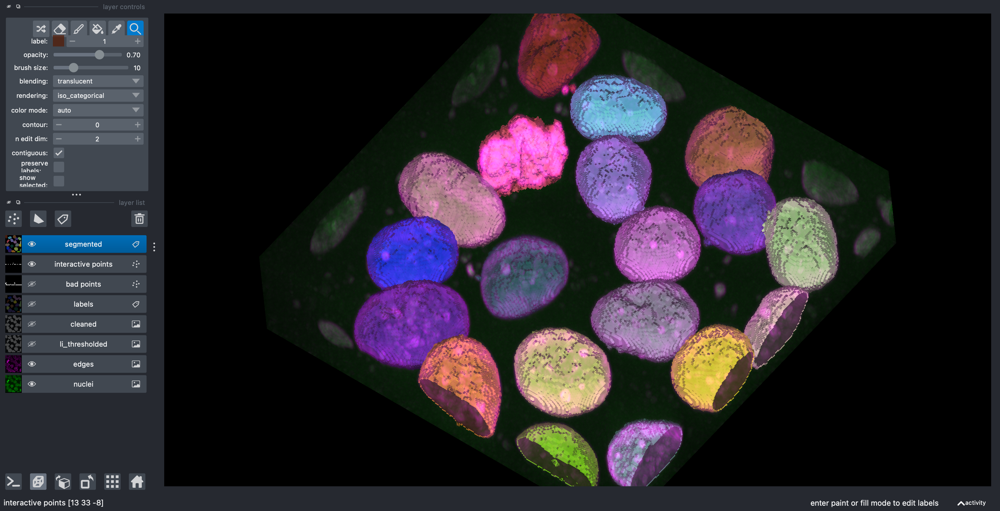

In [34]:
nbscreenshot(viewer)

After watershed, we have better disambiguation between internal cells!

## Making measurements

Once we have defined our objects, we can make measurements on them using `skimage.measure.regionprops` and the new `skimage.measure.regionprops_table`. These measurements include features such as area or volume, bounding boxes, and intensity statistics.

Before measuring objects, it helps to clear objects from the image border. Measurements should only be collected for objects entirely contained in the image.

Given the layer-like structure of our data, we only want to clear the objects touching the sides of the volume, but not the top and bottom, so we pad and crop the volume along the 0th axis to avoid clearing the mitotic nucleus.

In [35]:
segmented_padded = np.pad(
    segmented,
    ((1, 1), (0, 0), (0, 0)),
    mode='constant',
    constant_values=0,
)

In [36]:
interior_labels = segmentation.clear_border(segmented_padded)[1:-1]

`skimage.measure.regionprops` automatically measures many labeled image features. Optionally, an `intensity_image` can be supplied and intensity features are extracted per object. It's good practice to make measurements on the original image.

Not all properties are supported for 3D data. Below we build a list of supported and unsupported 3D measurements.

In [37]:
regionprops = measure.regionprops(interior_labels, intensity_image=nuclei)

supported = [] 
unsupported = []

for prop in regionprops[0]:
    try:
        regionprops[0][prop]
        supported.append(prop)
    except NotImplementedError:
        unsupported.append(prop)

print("Supported properties:")
print("  " + "\n  ".join(supported))
print()
print("Unsupported properties:")
print("  " + "\n  ".join(unsupported))

Supported properties:
  area
  area_bbox
  area_convex
  area_filled
  axis_major_length
  axis_minor_length
  bbox
  centroid
  centroid_local
  centroid_weighted
  centroid_weighted_local
  coords
  equivalent_diameter_area
  euler_number
  extent
  feret_diameter_max
  image
  image_convex
  image_filled
  image_intensity
  inertia_tensor
  inertia_tensor_eigvals
  intensity_max
  intensity_mean
  intensity_min
  label
  moments
  moments_central
  moments_normalized
  moments_weighted
  moments_weighted_central
  moments_weighted_normalized
  slice
  solidity

Unsupported properties:
  eccentricity
  moments_hu
  moments_weighted_hu
  orientation
  perimeter
  perimeter_crofton


scikit-image 0.18 adds support for [passing custom functions](https://scikit-image.org/docs/dev/api/skimage.measure.html#skimage.measure.regionprops) for region properties as `extra_properties`. After this tutorial, you might want to try it out to [determine the surface area](https://github.com/scikit-image/scikit-image/issues/3797#issuecomment-471277056) of the nuclei or cells!

`skimage.measure.regionprops` ignores the 0 label, which represents the background.

`regionprops_table` returns a dictionary of columns compatible with creating a pandas dataframe of properties of the data:

In [38]:
import pandas as pd


info_table = pd.DataFrame(
    measure.regionprops_table(
        interior_labels,
        intensity_image=nuclei,
        properties=['label', 'slice', 'area', 'mean_intensity', 'solidity'],
    )
).set_index('label')

In [39]:
info_table.head()

,slice,area,mean_intensity,solidity
label,,,,
2,"(slice(20, 53, None), slice(13, 55, None), sli...",37410,0.189264,0.930666
3,"(slice(19, 51, None), slice(47, 99, None), sli...",40504,0.185613,0.911985
5,"(slice(19, 55, None), slice(26, 71, None), sli...",36054,0.211766,0.922923
6,"(slice(20, 52, None), slice(23, 75, None), sli...",36993,0.181161,0.913002
7,"(slice(19, 54, None), slice(72, 121, None), sl...",40130,0.211141,0.894242


We can now use pandas and seaborn for some analysis!

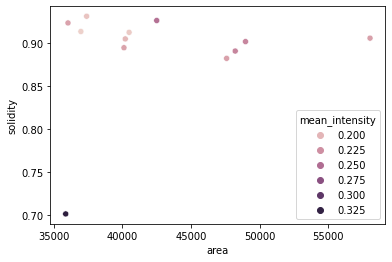

In [41]:
import seaborn as sns

sns.scatterplot(x='area', y='solidity', data=info_table, hue='mean_intensity');

We can see that the mitotic nucleus is a clear outlier from the others in terms of solidity and intensity.

### <span style="color:cornflowerblue">Exercise: physical measurements</span>

The "area" property above is actually the volume of the region, measured in voxels. Add a new column to your dataframe, `'area_um3'`, containing the volume in µm&sup3;.

In [42]:
info_table['area_um3'] = info_table['area'] * 0.29 * 0.26 * 0.26

In [43]:
info_table['area_um3']

label
2      733.385640
3      794.040416
5      706.802616
6      725.210772
7      786.708520
8      933.228816
10     960.184316
11     833.444456
12     945.520524
13     788.590504
14    1137.933784
19     703.489540
Name: area_um3, dtype: float64

### <span style="color:cornflowerblue">Exercise: full cell segmentation</span>

Above, we loaded the membranes image into memory, but we have yet to use it.

- Add the membranes to the image.
- Use watershed to segment the full cells, and add the segmentation to the display

### <span style="color:cornflowerblue">Exercise: displaying regionprops (or other values)</span>

Now that you have segmented cells, (or even with just the nuclei), use [`skimage.util.map_array`](https://scikit-image.org/docs/dev/api/skimage.util.html#skimage.util.map_array) to display a volume of the value of a regionprop (say, 'solidity' of the cells) on top of the segments.

In [ ]:
import numpy as np
from skimage.feature import blob_log
from scipy import ndimage as ndi


def gaussian_high_pass(image: np.ndarray, sigma: float = 2):
    """Apply a gaussian high pass filter to an image.

    Parameters
    ----------
    image : np.ndarray
        The image to be filtered.
    sigma : float
        The sigma (width) of the gaussian filter to be applied.
        The default value is 2.
    
    Returns
    -------
    high_passed_im : np.ndarray
        The image with the high pass filter applied
    """
    low_pass = ndi.gaussian_filter(image, sigma)
    high_passed_im = image - low_pass
    
    return high_passed_im


def detect_spots(
    image: np.ndarray,
    high_pass_sigma: float = 2,
    spot_threshold: float = 0.01,
    blob_sigma: float = 2
):
    """Apply a gaussian high pass filter to an image.

    Parameters
    ----------
    image : np.ndarray
        The image in which to detect the spots.
    high_pass_sigma : float
        The sigma (width) of the gaussian filter to be applied.
        The default value is 2.
    spot_threshold : float
        The threshold to be passed to the blob detector.
        The default value is 0.01.
    blob_sigma: float
        The expected sigma (width) of the spots. This parameter
        is passed to the "max_sigma" parameter of the blob
        detector.
    
    Returns
    -------
    points_coords : np.ndarray
        An NxD array with the coordinate for each detected spot.
        N is the number of spots and D is the number of dimensions.
    sizes : np.ndarray
        An array of size N, where N is the number of detected spots
        with the diameter of each spot.
    
    """
    # filter the image
    filtered_spots = gaussian_high_pass(image, high_pass_sigma)

    # detect the spots on the filtered image
    blobs_log = blob_log(
        filtered_spots,
        max_sigma=blob_sigma,
        num_sigma=1,
        threshold=spot_threshold
    )
    
    # convert the output of the blob detector to the 
    # desired points_coords and sizes arrays
    # (see the docstring for details)
    points_coords = blobs_log[:, 0:2]
    sizes = 2 * np.sqrt(2) * blobs_log[:, 2]

    return points_coords, sizes

# Use the gaussian_high_pass function to filter the spots image
filtered_spots = gaussian_high_pass(spots, 2)

# detect the spots
spot_coords, spot_sizes = detect_spots(
    spots,
    high_pass_sigma=2,
    spot_threshold=0.01,
    blob_sigma=2
)
